In [1]:
import tensorflow as tf
import sys

sys.path.append('../')

from src.Objective import Objective
from src.Parameterization import Parameterization
from src.Transformation import *
from src.Regularizer import *
from src.Optimizer import *
from src.Miscellaneous import load_files, plot_all
from src.Attribution import *
from src.Wrapper import *

print(tf.__version__)
print(tf.config.list_physical_devices('GPU'))

2.10.0
[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


## Model selection

In [2]:
# Model names: https://keras.io/api/applications/

model = Wrapper(model = 'InceptionV3')

print(model.layers())

['input_1', 'conv2d', 'batch_normalization', 'activation', 'conv2d_1', 'batch_normalization_1', 'activation_1', 'conv2d_2', 'batch_normalization_2', 'activation_2', 'max_pooling2d', 'conv2d_3', 'batch_normalization_3', 'activation_3', 'conv2d_4', 'batch_normalization_4', 'activation_4', 'max_pooling2d_1', 'conv2d_8', 'batch_normalization_8', 'activation_8', 'conv2d_6', 'conv2d_9', 'batch_normalization_6', 'batch_normalization_9', 'activation_6', 'activation_9', 'average_pooling2d', 'conv2d_5', 'conv2d_7', 'conv2d_10', 'conv2d_11', 'batch_normalization_5', 'batch_normalization_7', 'batch_normalization_10', 'batch_normalization_11', 'activation_5', 'activation_7', 'activation_10', 'activation_11', 'mixed0', 'conv2d_15', 'batch_normalization_15', 'activation_15', 'conv2d_13', 'conv2d_16', 'batch_normalization_13', 'batch_normalization_16', 'activation_13', 'activation_16', 'average_pooling2d_1', 'conv2d_12', 'conv2d_14', 'conv2d_17', 'conv2d_18', 'batch_normalization_12', 'batch_normaliza

# Activation atlas

### Directions

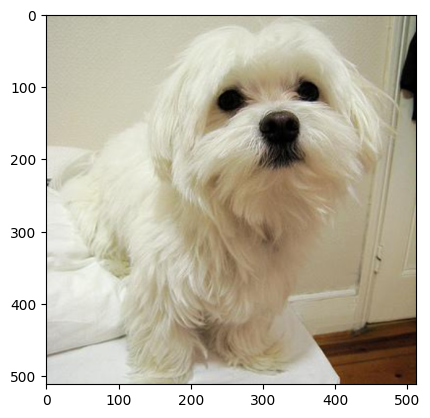

In [3]:
# Image path for model directions 
# (more details on direction at the objectives tutorial)
path = '../src/imagenet-examples/n02085936_Maltese_dog.jpg'

image = load_image((1, 512, 512, 3), path)[0]
plt.imshow(image)
plt.show()

### Activation atlas algorithm

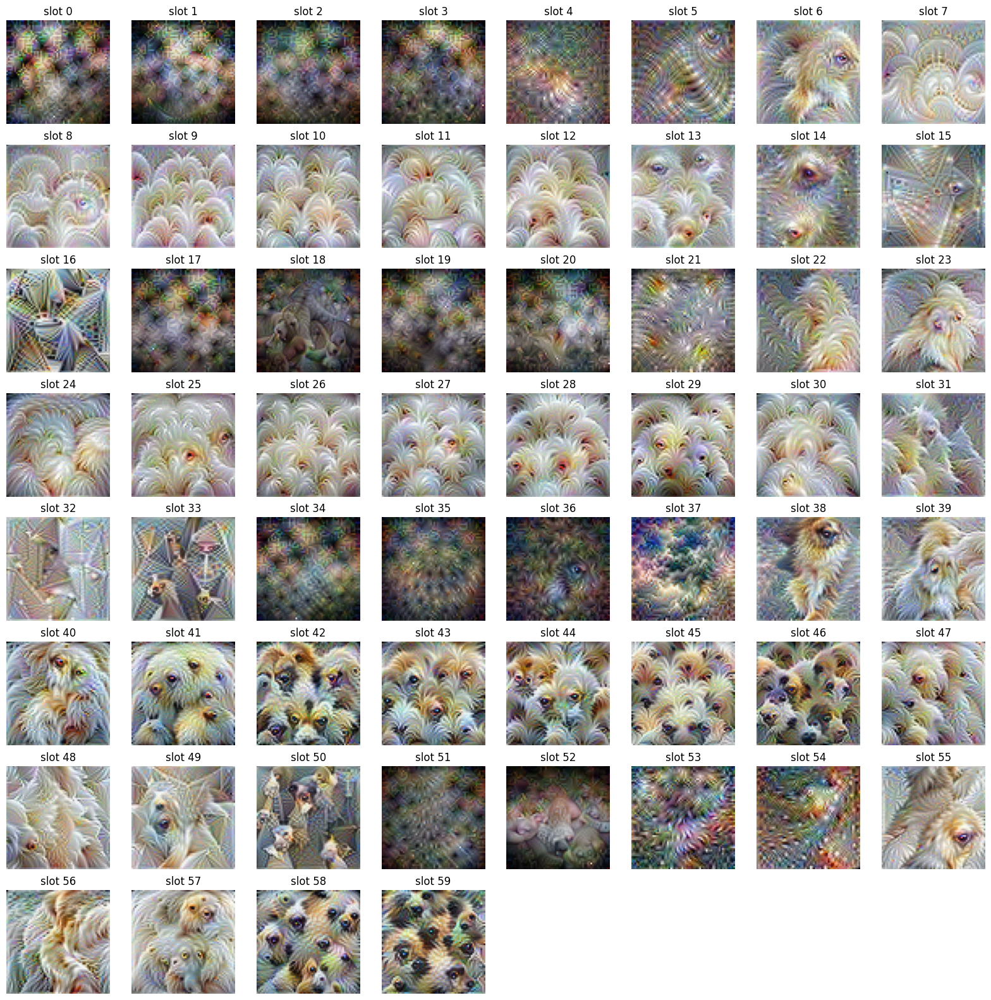

In [4]:
# Layer name
layer = 'mixed5'

# takes two long - just 100 steps and 10/50 samples/batches
images = run_activation_atlas(path, model, layer, 
                              batches = 50, samples = 10,
                              steps = 100, image_shape = (64, 64),
                              verbose = False)

plot_all(images)

# Activation layers

### Directions

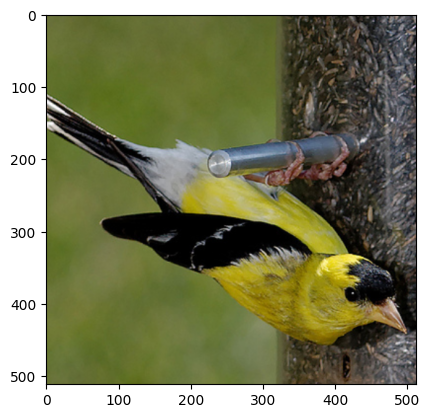

In [ ]:
# Image path for model directions 
# (more details on direction at the objectives tutorial)
path = '../src/imagenet-examples/n01531178_goldfinch.jpg'

image = load_image((1, 512, 512, 3), path)[0]
plt.imshow(image)
plt.show()

### Layers

In [ ]:
layers_alias = 'mixed'
layers = []

for l in model.layers():
    if layers_alias in l:
        layers.append(l)

print(layers)

['mixed0', 'mixed1', 'mixed2', 'mixed3', 'mixed4', 'mixed5', 'mixed6', 'mixed7', 'mixed8', 'mixed9_0', 'mixed9', 'mixed9_1', 'mixed10']


### Activation layers algorithm

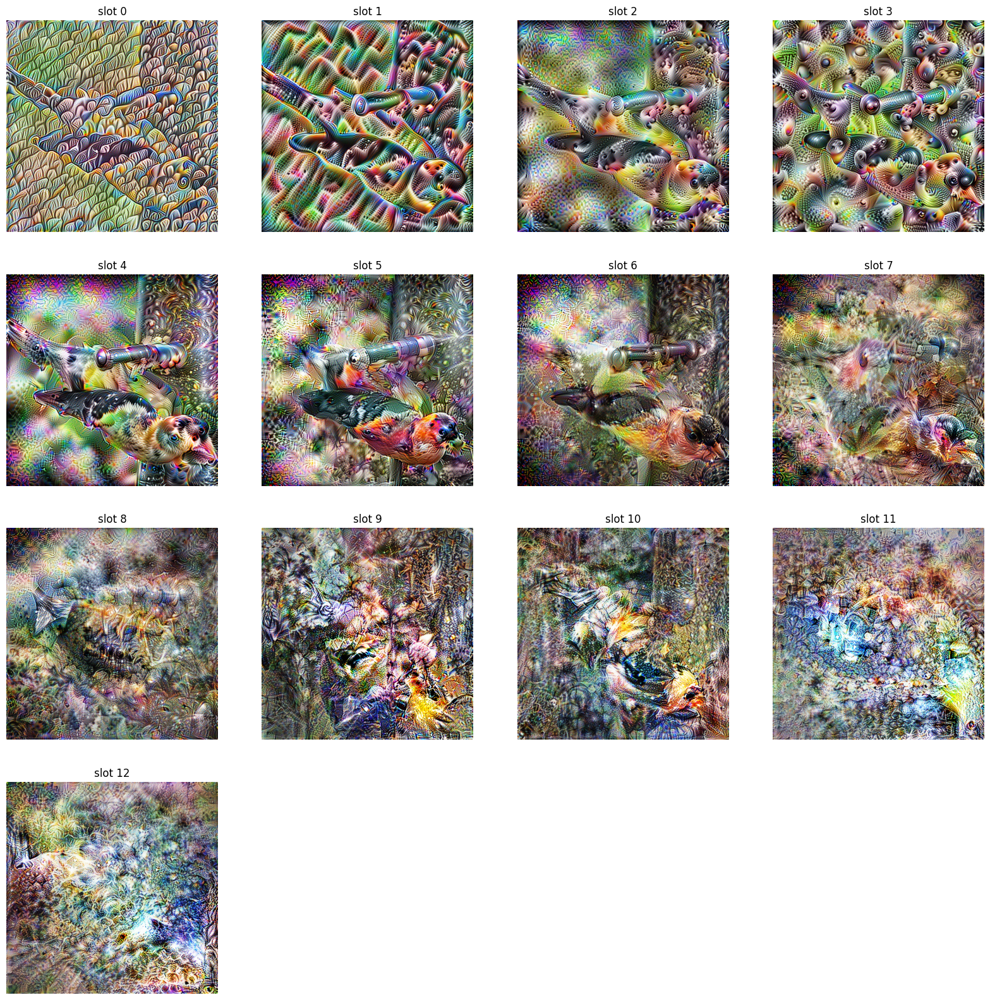

In [ ]:
images = run_activation_layer(path, model, layers,
                              steps = 500, verbose = False)

plot_all(images)

# Neuron interaction inside a channel

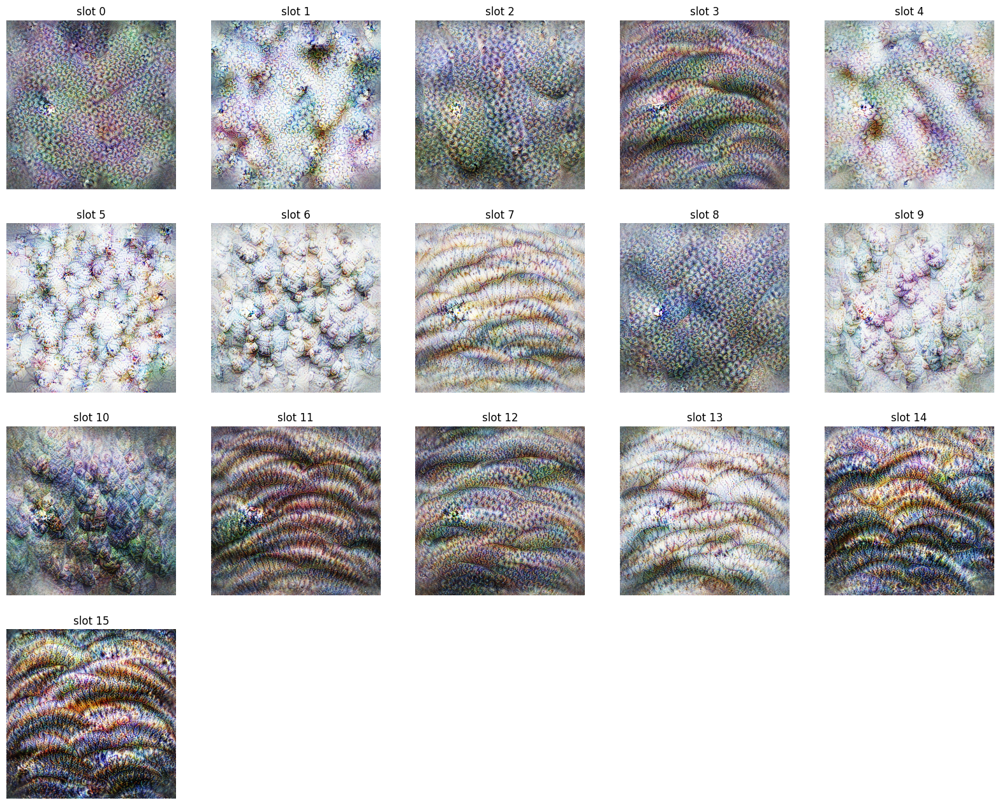

In [ ]:
# layer - channel that the neurons make part of
neurons = [
    ('mixed5', 13),
    ('mixed5', 76),
    ('mixed5', 234),
    ('mixed5', 378)
]   

images = run_neuron_interaction(model, neurons, 
                                steps = 500, verbose = False)

plot_all(images)

# Feature inversion

### Directions

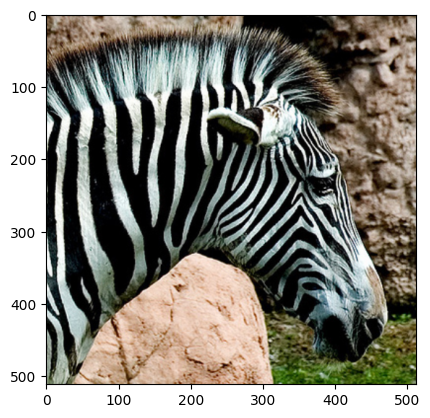

In [ ]:
# Image path for model directions 
# (more details on direction at the objectives tutorial)
path = '../src/imagenet-examples/n02391049_zebra.jpg'

image = load_image((1, 512, 512, 3), path)[0]
plt.imshow(image)
plt.show()

### Layers

In [ ]:
layers_alias = 'mixed'
layers = []

for l in model.layers():
    if layers_alias in l:
        layers.append(l)

print(layers)

['mixed0', 'mixed1', 'mixed2', 'mixed3', 'mixed4', 'mixed5', 'mixed6', 'mixed7', 'mixed8', 'mixed9_0', 'mixed9', 'mixed9_1', 'mixed10']


### Feature inversion algorithm

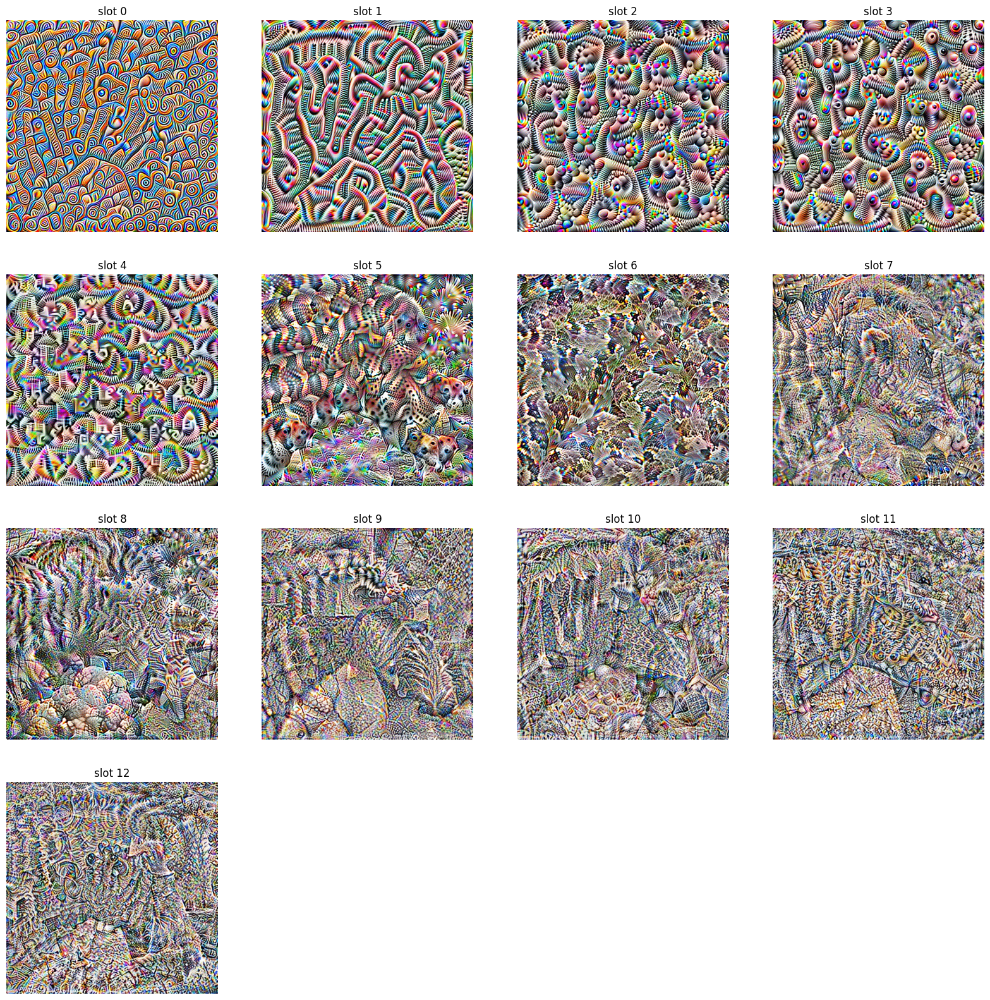

In [ ]:
images = run_feature_inversion(path, model, layers, 
                               steps = 500, verbose = False)

plot_all(images)

# Style Transfer

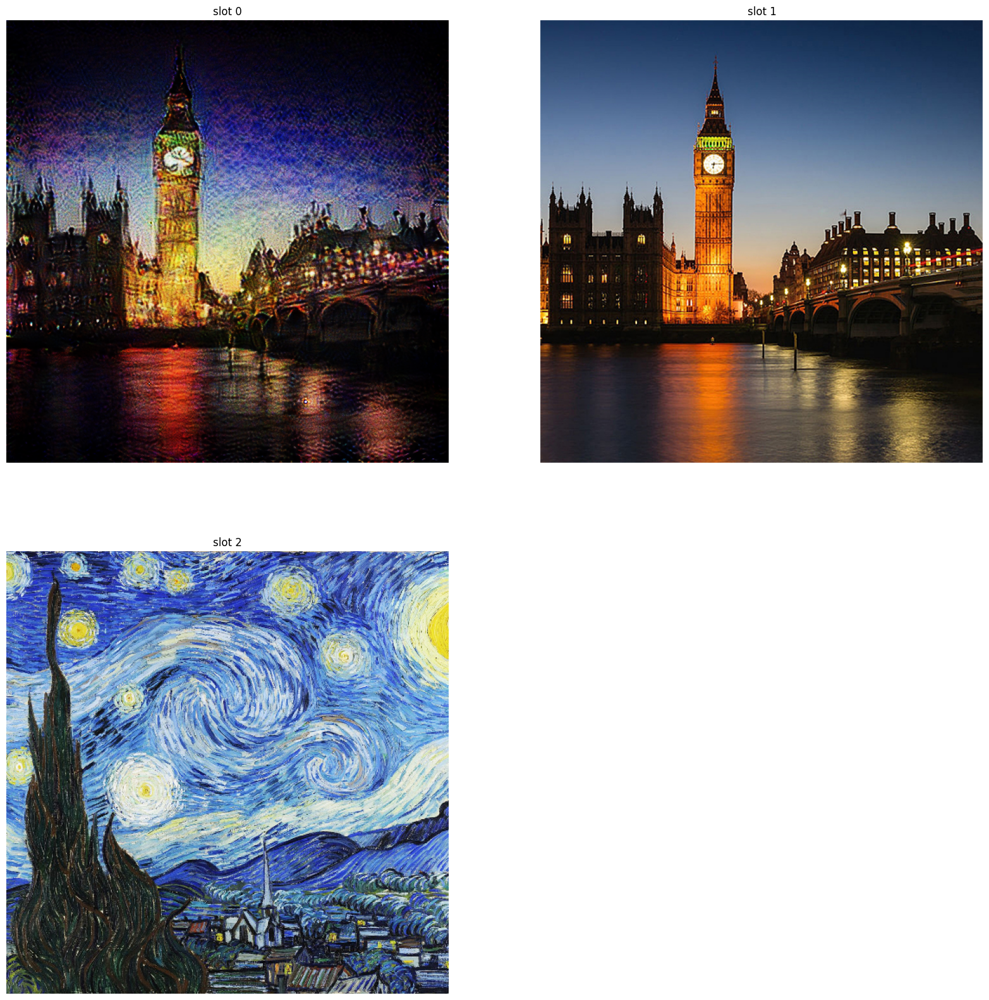

In [5]:
original = '..\src\imagenet-examples\london.png'
style = '..\src\imagenet-examples\\neural_style_transfer_5_1.jpg'

layers = ['mixed3'] 

style_layers = ['mixed5',
                'mixed7', 
                'mixed9']


images = run_style_transfer(original, style, model,
                            layers, style_layers,
                            steps = 1000, 
                            verbose = False)

plot_all(images)

# Attribution

### Image in analisys

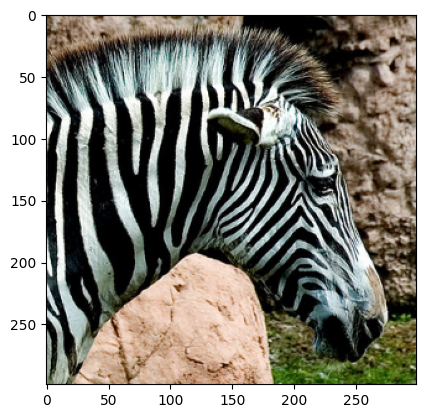

In [3]:
# Image path for model directions 
# (more details on direction at the objectives tutorial)
path = '../src/imagenet-examples/n02391049_zebra.jpg'

image = load_image(model.get_input_shape(), path)
plt.imshow(image[0])
plt.show()

### Attribution algorithm

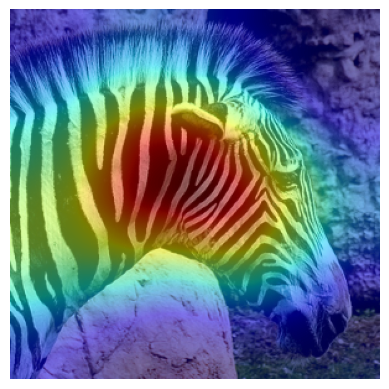

In [5]:
attribution = GradientCAM(model)

# predictions index from the image
label = np.argmax(model.predict(image))

explanation = attribution.explainer(image, [tf.keras.utils.to_categorical(label, 1000)])

plot_attribution(explanation[0], image[0])